In [1]:
import collections
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
from IPython.display import Image, display

from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector,\
                         Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.optimizers import Adam, RMSprop
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras import Input, layers
from keras import optimizers
from keras.applications.inception_v3 import preprocess_input
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras.preprocessing.image import load_img, img_to_array
from keras.callbacks import EarlyStopping
from keras.utils import plot_model

Using TensorFlow backend.


In [2]:
img_dir = "data/Flicker8k_Dataset/"
caption_file = "data/Flickr8k_text/Flickr8k.token.txt"

### Build a Image to Caption Map

In [3]:
img_captions = pd.read_csv(caption_file, header=None, delimiter="\t")

img2captions = collections.defaultdict(list)

for img_name, caption in zip(img_captions[0], img_captions[1]):
    img = img_name.split("#")[0]
    img2captions[img].append(caption)
    
img2captions["1000268201_693b08cb0e.jpg"]

['A child in a pink dress is climbing up a set of stairs in an entry way .',
 'A girl going into a wooden building .',
 'A little girl climbing into a wooden playhouse .',
 'A little girl climbing the stairs to her playhouse .',
 'A little girl in a pink dress going into a wooden cabin .']

### Take a look at the dataset (image and it's captions)

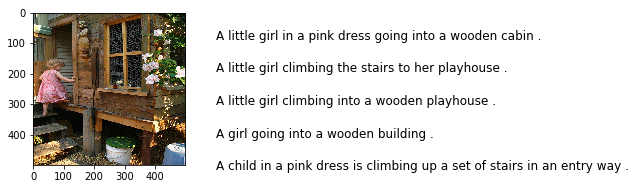

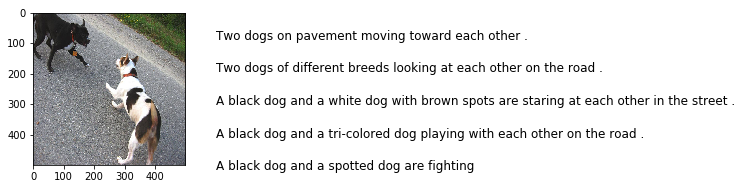

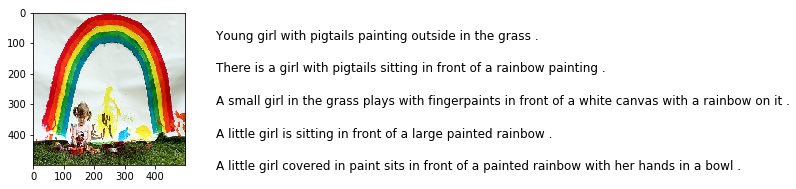

In [4]:
def display_img_with_caption(img):
    fig = plt.figure(figsize = (6, 3))
    
    img_file = img_dir + img
    img_load = load_img(img_file, target_size=(500, 500))
    ax = fig.add_subplot(121)
    ax.imshow(img_load)
    
    captions = img2captions[img]
    ax = fig.add_subplot(122)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0, 1)
    ax.set_ylim(0, len(captions))
    for i, caption in enumerate(captions):
        ax.text(0, i, caption, fontsize=12) 
    plt.show()
    
for img in list(img2captions.keys())[0:3]:
    display_img_with_caption(img)

### Add start and end sequence tokens

In [5]:
for img, captions in img2captions.items():
    img2captions[img] = ['startseq ' + text + ' endseq' for text in captions]
    
img2captions["1000268201_693b08cb0e.jpg"]

['startseq A child in a pink dress is climbing up a set of stairs in an entry way . endseq',
 'startseq A girl going into a wooden building . endseq',
 'startseq A little girl climbing into a wooden playhouse . endseq',
 'startseq A little girl climbing the stairs to her playhouse . endseq',
 'startseq A little girl in a pink dress going into a wooden cabin . endseq']

### Clean up Captions

In [6]:
import string
table = str.maketrans(dict.fromkeys(string.punctuation))

vocab = set()

for img_id, captions in img2captions.items():
    for i in range(len(captions)):
        caption = captions[i]
        
        words = caption.split()
        words = [word.lower() for word in words]
        # Remove punctuation
        words = [word.translate(table) for word in words]
        # Remove single character word
        words = [word for word in words if len(word) > 1]
        # Remove words that contain numeric values
        words = [word for word in words if word.isalpha()]
        
        vocab = vocab | set(words)
        
        cleaned_caption = " ".join(words)
        img2captions[img_id][i] = cleaned_caption

print("There are {} vocabs".format(len(vocab)))

list(img2captions.values())[:5]

There are 8765 vocabs


[['startseq child in pink dress is climbing up set of stairs in an entry way endseq',
  'startseq girl going into wooden building endseq',
  'startseq little girl climbing into wooden playhouse endseq',
  'startseq little girl climbing the stairs to her playhouse endseq',
  'startseq little girl in pink dress going into wooden cabin endseq'],
 ['startseq black dog and spotted dog are fighting endseq',
  'startseq black dog and tricolored dog playing with each other on the road endseq',
  'startseq black dog and white dog with brown spots are staring at each other in the street endseq',
  'startseq two dogs of different breeds looking at each other on the road endseq',
  'startseq two dogs on pavement moving toward each other endseq'],
 ['startseq little girl covered in paint sits in front of painted rainbow with her hands in bowl endseq',
  'startseq little girl is sitting in front of large painted rainbow endseq',
  'startseq small girl in the grass plays with fingerpaints in front of

### Load train and test image names

In [7]:
train_imgs = pd.read_csv("data/Flickr8k_text/Flickr_8k.trainImages.txt", header=None)
train_imgs = list(train_imgs[0])

test_imgs = pd.read_csv("data/Flickr8k_text/Flickr_8k.testImages.txt", header=None)
test_imgs = list(test_imgs[0])

print("There are {} train images.".format(len(train_imgs)))
print("There are {} test images.".format(len(test_imgs)))
print("Example image id : {}".format(train_imgs[0]))

There are 6000 train images.
There are 1000 test images.
Example image id : 2513260012_03d33305cf.jpg


### Load train and test image captions

In [8]:
img2captions_train = {}
for img in train_imgs:
    img2captions_train[img] = img2captions[img]
    
    
img2captions_test = {}
for img in test_imgs:
    img2captions_test[img] = img2captions[img]

print("There are {} train images with captions.".format(len(img2captions_train)))
print("There are {} test images with captions.".format(len(img2captions_test)))

img2captions_train["1000268201_693b08cb0e.jpg"]

There are 6000 train images with captions.
There are 1000 test images with captions.


['startseq child in pink dress is climbing up set of stairs in an entry way endseq',
 'startseq girl going into wooden building endseq',
 'startseq little girl climbing into wooden playhouse endseq',
 'startseq little girl climbing the stairs to her playhouse endseq',
 'startseq little girl in pink dress going into wooden cabin endseq']

### Build vocab

In [9]:
print("There are {} vocabs".format(len(vocab)))

There are 8765 vocabs


### Get caption max length

In [10]:
max_length = 0

for _, captions in img2captions.items():
    max_length = max(max_length, max([len(text.split()) for text in captions]))

print("Max length of a captions is {} (including startseq and endseq)".format(max_length))


Max length of a captions is 34 (including startseq and endseq)


### Image Embedding

In [11]:
# Get the InceptionV3 model trained on imagenet data
model = InceptionV3(weights='imagenet')
# Remove the last layer (output softmax layer) from the inception v3
encoder_model = Model(model.input, model.layers[-2].output)

W1116 01:12:05.062606 4547128768 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4070: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.

W1116 01:12:05.511806 4547128768 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4074: The name tf.nn.avg_pool is deprecated. Please use tf.nn.avg_pool2d instead.



In [12]:
def encode(img_file):
    img = image.load_img(img_file, target_size=(299, 299))
    x = image.img_to_array(img)
    # Add one more dimension
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    vec = encoder_model.predict(x)
    vec = np.reshape(vec, vec.shape[1])
    return vec

encode(img_dir + "1000268201_693b08cb0e.jpg")

W1116 01:12:14.057592 4547128768 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:422: The name tf.global_variables is deprecated. Please use tf.compat.v1.global_variables instead.



array([0.12277617, 0.3329493 , 0.75271684, ..., 0.21939705, 0.30216393,
       0.4028317 ], dtype=float32)

In [13]:
import os
if not os.path.isfile("img2vec_train_8k.pkl"):
    img2vec_train = {}

    for i, img in enumerate(train_imgs):
        if i % 100 == 0:
            print("finish encoding {} images".format(i))
        img2vec_train[img] = encode(img_dir + img)

    print(len(img2vec_train))
    
    f = open('img2vec_train_8k.pkl', 'wb')
    pickle.dump(img2vec_train, f)          # dump data to f
    f.close()
    print("Saved img2vec_train.")
else:
    f = open('img2vec_train_8k.pkl','rb')
    print("img2vec_train_8k.pkl exist. Load it ...")
    img2vec_train = pickle.load(f)
    print("img2vec_train has length of {}".format(len(img2vec_train)))

img2vec_train_8k.pkl exist. Load it ...
img2vec_train has length of 6000


In [14]:
import os
if not os.path.isfile("img2vec_test_8k.pkl"):
    
    img2vec_test = {}

    for i, img in enumerate(test_imgs):
        if i % 100 == 0:
            print("finish encoding {} images".format(i))
        img2vec_test[img] = encode(img_dir + img)

    print(len(img2vec_test))
    
    f = open('img2vec_test_8k.pkl', 'wb')
    pickle.dump(img2vec_test, f)          # dump data to f
    f.close()
    print("Saved img2vec_test.")
else:
    f = open('img2vec_test_8k.pkl','rb')
    print("img2vec_test_8k.pkl exist. Load it ...")
    img2vec_test = pickle.load(f)
    print("img2vec_test has length of {}".format(len(img2vec_test)))

img2vec_test_8k.pkl exist. Load it ...
img2vec_test has length of 1000


### Word Embedding

In [15]:
word2idx = {}
idx2word = {}

idx = 1
for word in vocab:
    word2idx[word] = idx
    idx2word[idx] = word
    idx += 1
    
vocab_size = len(vocab) + 1
print("The vocab size with padding is {}".format(vocab_size))

The vocab size with padding is 8766


In [16]:
from gensim.scripts.glove2word2vec import glove2word2vec
from gensim.models.keyedvectors import KeyedVectors

if not os.path.isfile("data/gensim_glove_vectors.txt"):
    glove2word2vec(glove_input_file="data/glove.6B/glove.6B.300d.txt", word2vec_output_file="data/gensim_glove_vectors.txt")
word_vectors = KeyedVectors.load_word2vec_format("data/gensim_glove_vectors.txt", binary=False)
word_vectors

In [17]:
embedding_dim = 300

embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, idx in word2idx.items():
    if word in word_vectors:
        vec = word_vectors[word]
        embedding_matrix[idx] = vec
    
print(embedding_matrix.shape)

(8766, 300)


### Prepare model input

In [18]:
def preprocessing(img2vec, img2captions):
    Xtext, Ximg, ytext = [], [], []
    
    for img, img_vec in img2vec.items():
        captions = img2captions[img]
        
        for caption in captions:
            seq = [word2idx[word] for word in caption.split() if word in word2idx]
            
            for i in range(1, len(seq)):
                in_seq, out_seq = seq[:i], seq[i]
                # pad in the input sequence
                in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                
                Xtext.append(in_seq)
                Ximg.append(img_vec)
                ytext.append(out_seq)
                
    Xtext  = np.array(Xtext)
    Ximg = np.array(Ximg)
    ytext  = np.array(ytext)
                
    print(" {} {} {}".format(Xtext.shape,Ximg.shape,ytext.shape))
    return Xtext, Ximg, ytext

In [19]:
Xtext_train, Ximg_train, ytext_train = preprocessing(img2vec_train,img2captions)
Xtext_val,   Ximg_val,   ytext_val   = preprocessing(img2vec_test,img2captions)

 (306404, 34) (306404, 2048) (306404, 8766)
 (51287, 34) (51287, 2048) (51287, 8766)


In [63]:
np.save('Xtext_train.npy', Xtext_train) 
np.save('Ximg_train.npy', Ximg_train)
np.save('ytext_train.npy', ytext_train)
np.save('Xtext_val.npy', Xtext_val)
np.save('Ximg_val.npy', Ximg_val)
np.save('ytext_val.npy', ytext_val)

In [21]:
print(Xtext_train[1])
print(ytext_train[1])
print(Ximg_train[1])
print(idx2word[1802])
print(embedding_matrix[7249])

[   0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0 1802 8079]
[0. 0. 0. ... 0. 0. 0.]
[0.08447927 0.09467603 0.09230011 ... 0.0769059  1.4561858  0.45119157]
startseq
[-1.73690006e-01  1.05319999e-01  2.35990003e-01 -1.97369996e-02
 -2.21469998e-01 -4.94549982e-02  3.92960012e-01  1.15690000e-01
 -2.56550014e-01 -1.00619996e+00  2.79429997e-03 -4.61519986e-01
  3.25949997e-01 -7.80780017e-02 -4.64050006e-03  2.08859995e-01
 -2.88500011e-01 -2.08460003e-01 -3.77059996e-01 -4.43969995e-01
 -1.09180003e-01 -9.79769975e-02  3.66059989e-01  1.39559999e-01
 -4.16269988e-01 -2.91280001e-01 -1.54090002e-01  5.13270020e-01
 -1.10540003e-01  3.53749990e-02  1.29189998e-01 -7.11380020e-02
 -2.17610002e-01  1.63690001e-01 -5.25860012e-01  3.45730007e-01
  8.37009996e-02 -7.94910014e-01  4.43000011e-02  3.73490006e-01
 -9.44530010e-01  5.03310025e-01  1.07639998e-01  8.34760010e-01
 -2.76

W1116 01:17:41.649276 4547128768 deprecation.py:323] From /usr/local/lib/python3.7/site-packages/tensorflow/python/keras/backend.py:3794: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


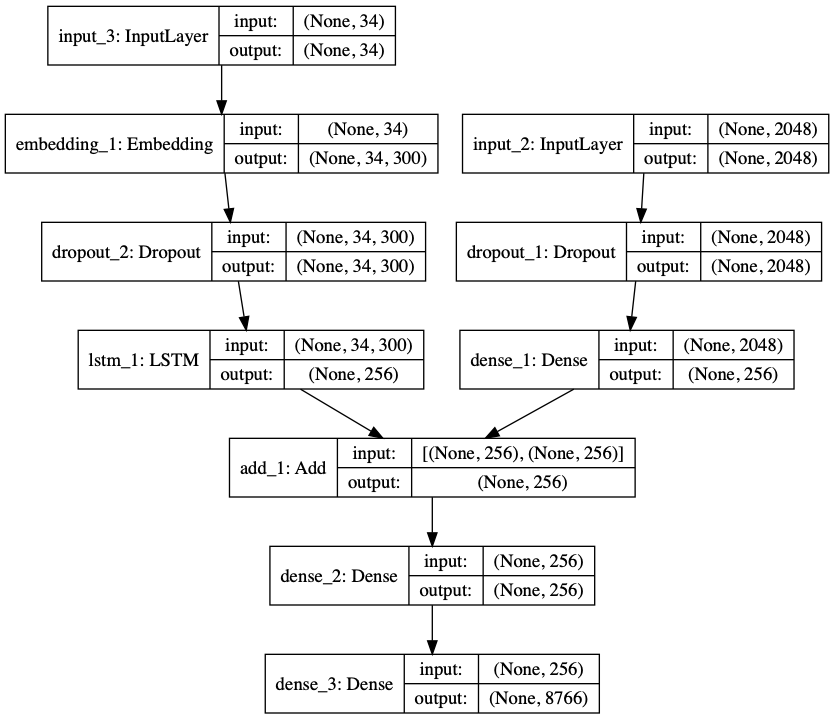

In [22]:
input_image = Input(shape=(Ximg_train.shape[1],))
fimage = Dropout(0.5)(input_image)
fimage = Dense(256, activation="relu")(fimage)

input_txt = Input(shape=(max_length,))
ftxt = Embedding(vocab_size, embedding_dim, weights=[embedding_matrix], trainable=False, mask_zero=True)(input_txt)
ftxt = Dropout(0.5)(ftxt)
ftxt = LSTM(256)(ftxt)

decoder = add([fimage, ftxt])
decoder = Dense(256, activation='relu')(decoder)
outputs = Dense(vocab_size, activation='softmax')(decoder)
model = Model(inputs=[input_image, input_txt], outputs=outputs)

plot_model(model, show_shapes=True)




In [23]:
model.compile(loss='categorical_crossentropy', optimizer='adam')

In [24]:
# define early stopping callbacks
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.01, verbose=2)
callbacks_list = [early_stopping]

In [25]:
import time
start = time.time()

hist = model.fit(
    [Ximg_train, Xtext_train], 
    ytext_train, 
    epochs=30, 
    verbose=2, 
    batch_size=2048,
    validation_split=0.1,
    callbacks=callbacks_list
)

end = time.time()
print("TIME TOOK {:3.2f}MIN".format((end - start )/60))

Train on 275763 samples, validate on 30641 samples
Epoch 1/30
 - 368s - loss: 5.4314 - val_loss: 4.5467
Epoch 2/30
 - 363s - loss: 4.1885 - val_loss: 4.0283
Epoch 3/30
 - 384s - loss: 3.7510 - val_loss: 3.8211
Epoch 4/30
 - 391s - loss: 3.4869 - val_loss: 3.7255
Epoch 5/30
 - 384s - loss: 3.3000 - val_loss: 3.6792
Epoch 6/30
 - 377s - loss: 3.1551 - val_loss: 3.6602
Epoch 7/30
 - 381s - loss: 3.0357 - val_loss: 3.6609
Epoch 00007: early stopping
TIME TOOK 44.16MIN


In [28]:
model.save('img2text_model.h5')

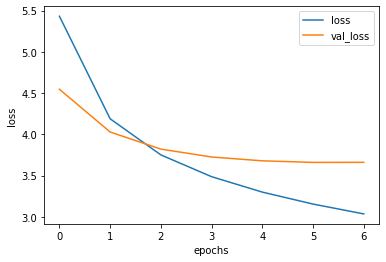

In [29]:
for label in ["loss","val_loss"]:
    plt.plot(hist.history[label],label=label)
plt.legend()
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()

## Evaluate the model

### Bleu score - test + greedy search

In [55]:
from nltk.translate.bleu_score import corpus_bleu

#the below function evaluates the skill of the model
actual, predicted = list(), list()
for img, captions in img2captions_test.items():
    actual_captions = [caption.split()[1:-1] for caption in captions]
    actual.append(actual_captions)
    
    img_vec = img2vec_test[img]
    prediction = greedy_search(img_vec)
    predicted.append(prediction.split())

print('Cumulative 1-gram: %f' % corpus_bleu(actual, predicted, weights=(1, 0, 0, 0)))
print('Cumulative 2-gram: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
print('Cumulative 3-gram: %f' % corpus_bleu(actual, predicted, weights=(0.33, 0.33, 0.33, 0)))
print('Cumulative 4-gram: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))

Cumulative 1-gram: 0.492233
Cumulative 2-gram: 0.294268
Cumulative 3-gram: 0.174725
Cumulative 4-gram: 0.098506


### Bleu score - train + greedy search

In [56]:
from nltk.translate.bleu_score import corpus_bleu

#the below function evaluates the skill of the model
actual, predicted = list(), list()
for img, captions in img2captions_train.items():
    actual_captions = [caption.split()[1:-1] for caption in captions]
    actual.append(actual_captions)
    
    img_vec = img2vec_train[img]
    prediction = greedy_search(img_vec)
    predicted.append(prediction.split())

print('Cumulative 1-gram: %f' % corpus_bleu(actual, predicted, weights=(1, 0, 0, 0)))
print('Cumulative 2-gram: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
print('Cumulative 3-gram: %f' % corpus_bleu(actual, predicted, weights=(0.33, 0.33, 0.33, 0)))
print('Cumulative 4-gram: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))

Cumulative 1-gram: 0.537286
Cumulative 2-gram: 0.345090
Cumulative 3-gram: 0.219873
Cumulative 4-gram: 0.134002


### Bleu score - test + beam search

In [62]:
from nltk.translate.bleu_score import corpus_bleu

#the below function evaluates the skill of the model
actual, predicted = list(), list()
for img, captions in img2captions_test.items():
    actual_captions = [caption.split()[1:-1] for caption in captions]
    actual.append(actual_captions)
    
    img_vec = img2vec_test[img]
    prediction = beam_search(img_vec, k=5)[0][0][1:-1]
    predicted.append(prediction)

print('Cumulative 1-gram: %f' % corpus_bleu(actual, predicted, weights=(1, 0, 0, 0)))
print('Cumulative 2-gram: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
print('Cumulative 3-gram: %f' % corpus_bleu(actual, predicted, weights=(0.33, 0.33, 0.33, 0)))
print('Cumulative 4-gram: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))

Cumulative 1-gram: 0.515445
Cumulative 2-gram: 0.333562
Cumulative 3-gram: 0.217388
Cumulative 4-gram: 0.132442


## Inference

### Greedy search

In [30]:
def greedy_search(img_vec):
    in_text = 'startseq'
    
    for i in range(max_length):
        sequence = [word2idx[word] for word in in_text.split() if word in word2idx]
        sequence = pad_sequences([sequence], maxlen=max_length)
        
        yhat = model.predict([img_vec.reshape((1,2048)), sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = idx2word[yhat]
        in_text += " " + word
        if word == 'endseq':
            break
            
    final = in_text.split()
    final = final[1:-1]
    
    return " ".join(final)

### Beam Search with Length Normalization

In [31]:
def beam_search(img_vec, k = 3):
    sequences = [[['startseq'], 0.0]]
    
    for i in range(max_length - 1):
        all_candidates = []
        for i in range(len(sequences)):
            seq, score = sequences[i]
            if seq[-1] == "endseq":
                all_candidates.append(sequences[i])
                continue
            
            sequence = [word2idx[word] for word in seq if word in word2idx]
            sequence = pad_sequences([sequence], maxlen=max_length)
            
            yhat = model.predict([img_vec.reshape((1,2048)), sequence], verbose=0)
            yhat = np.log(yhat)
            for j in range(1, yhat.shape[1]):
                candidate = [seq + [idx2word[j]], score + yhat[0][j]]
                all_candidates.append(candidate)
                
                
        ordered = sorted(
            all_candidates, 
            key=lambda tup: tup[1] / len(tup[0]), 
            reverse=True
        )
        
        sequences = ordered[:k]   

            
    return sequences

### Bleu score

In [32]:
from nltk.translate.bleu_score import sentence_bleu

def calculate_bleu_score(references, hypothesis):
    print("\tBleu scores: ", end = "")
    print('Cumulative 1-4 gram: %.2f' % sentence_bleu(references, hypothesis, weights=(1, 0, 0, 0)), end =" | ")
    print('%.2f' % sentence_bleu(references, hypothesis, weights=(0.5, 0.5, 0, 0)), end =" | ")
    print('%.2f' % sentence_bleu(references, hypothesis, weights=(0.33, 0.33, 0.33, 0)), end =" | ")
    print('%.2f' % sentence_bleu(references, hypothesis, weights=(0.25, 0.25, 0.25, 0.25)))
                                                     
hypothesis = "A little girl climbing the stairs to her playhouse"
hypothesis = hypothesis.split()

reference = "A little girl climbing the stairs a wooden playhouse"
references = [reference.split()] ## references must be a list containing list.

calculate_bleu_score(references, hypothesis)

	Bleu scores: Cumulative 1-4 gram: 0.78 | 0.70 | 0.66 | 0.61


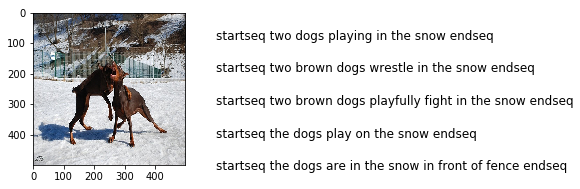

greedy_search: brown dog is running through the snow

Beam search: brown dog is running through the snow

	Beam width: 1
	Bleu scores: Cumulative 1-4 gram: 0.43 | 0.27 | 0.00 | 0.00


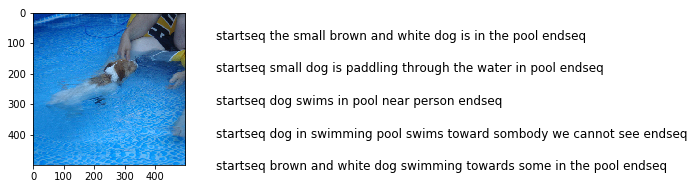

greedy_search: two dogs are playing in the water

Beam search: two dogs play in the water

	Beam width: 3
	Bleu scores: Cumulative 1-4 gram: 0.50 | 0.45 | 0.00 | 0.00


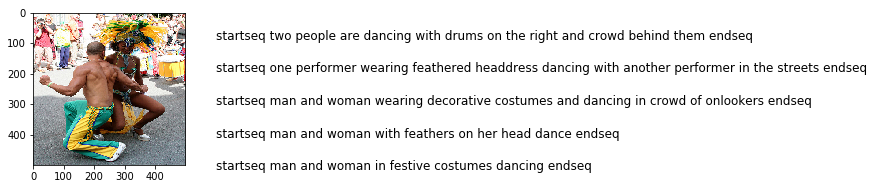

greedy_search: man in blue shirt and blue shirt is standing on the street

Beam search: man in blue shirt and white shirt is standing on the street

	Beam width: 5
	Bleu scores: Cumulative 1-4 gram: 0.42 | 0.19 | 0.00 | 0.00


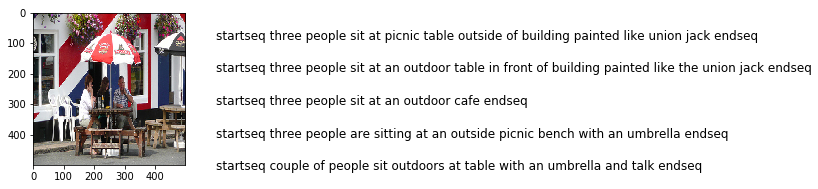

greedy_search: woman is sitting on bench at table at table

Beam search: man and woman sit at table at table

	Beam width: 3
	Bleu scores: Cumulative 1-4 gram: 0.50 | 0.38 | 0.00 | 0.00


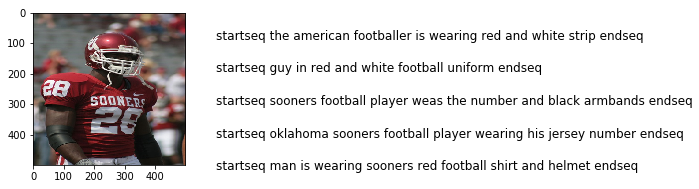

greedy_search: football player in white and white uniform is tackling the football

Beam search: football player in red and white is tackling the football

	Beam width: 5
	Bleu scores: Cumulative 1-4 gram: 0.80 | 0.60 | 0.45 | 0.34


In [46]:
beam_search_widths = [1, 3, 5, 7, 10]

for img, img_vec in list(img2vec_test.items())[:5]:
    display_img_with_caption(img)
    hypo_k_prob = []
    
    references = [caption.split()[1:-1] for caption in img2captions[img]]
    
    print("greedy_search: {}\n".format(greedy_search(img_vec)))
    assert(greedy_search(img_vec) == " ".join(beam_search(img_vec, 1)[0][0][1: -1]))
    
    for k in beam_search_widths:
#         print("Beam search with width {}:".format(k))
        hypothesises = beam_search(img_vec, k)
        for i in range(len(hypothesises)):
            hypothesis, prob = hypothesises[i]
            hypothesis = hypothesis[1:-1]
#             print("\tPredicted: {}".format(" ".join(hypothesis)))
            hypo_k_prob.append((hypothesis, k, prob))
            
    ordered = sorted(
        hypo_k_prob, 
        key=lambda tup: tup[2] / len(hypothesis), 
        reverse=True
    )
    
    top_1 = ordered[:1]
    
    for hypo, k, prob in top_1:
        print("Beam search: {}\n".format(" ".join(hypo)))
        print("\tBeam width: {}".format(k))
        calculate_bleu_score(references, hypo)


In [36]:
beam_search_widths = [1, 3, 5, 7, 10]

def inference(img_file):
    img_vec = encode(img_file)
    display(Image(filename=img_file, width=300, height=300))
    hypo_k_prob = []
    print("greedy_search: {}\n".format(greedy_search(img_vec)))
    assert(greedy_search(img_vec) == " ".join(beam_search(img_vec, 1)[0][0][1: -1]))
    
    for k in beam_search_widths:
#         print("Beam search with width {}:".format(k))
        hypothesises = beam_search(img_vec, k)
        for i in range(len(hypothesises)):
            hypothesis, prob = hypothesises[i]
            hypothesis = hypothesis[1:-1]
#             print("\tPredicted: {}".format(" ".join(hypothesis)))
            hypo_k_prob.append((hypothesis, k, prob))
            
    ordered = sorted(
        hypo_k_prob, 
        key=lambda tup: tup[2] / len(hypothesis), 
        reverse=True
    )
    
    top_1 = ordered[:1]
    
    for hypo, k, prob in top_1:
        print("Beam search: {}\n".format(" ".join(hypo)))
        print("\tBeam width: {}".format(k))

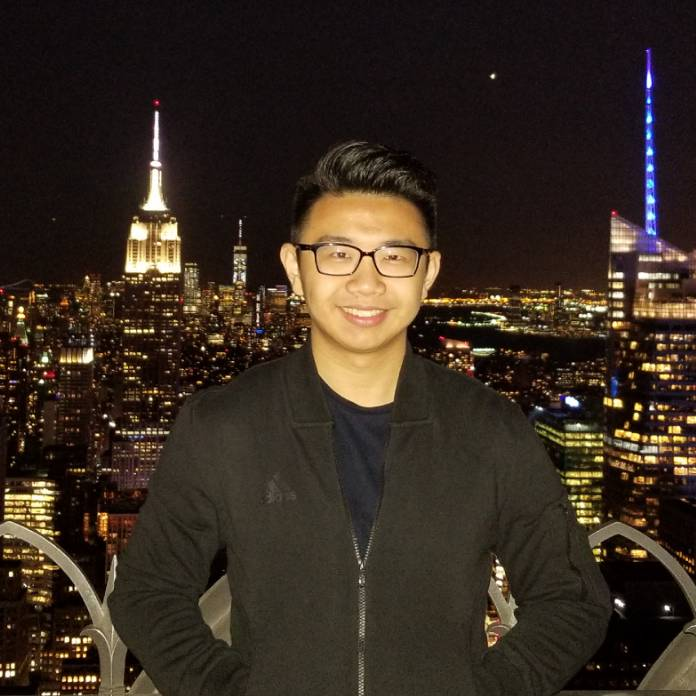

greedy_search: man in black shirt and woman in black and white are standing in front of an arcade table

Beam search: man and woman stand in front of restaurant

	Beam width: 5


In [37]:
img_file = "/Users/zhidongzhang/Desktop/4A/Profile.jpg"

inference(img_file)

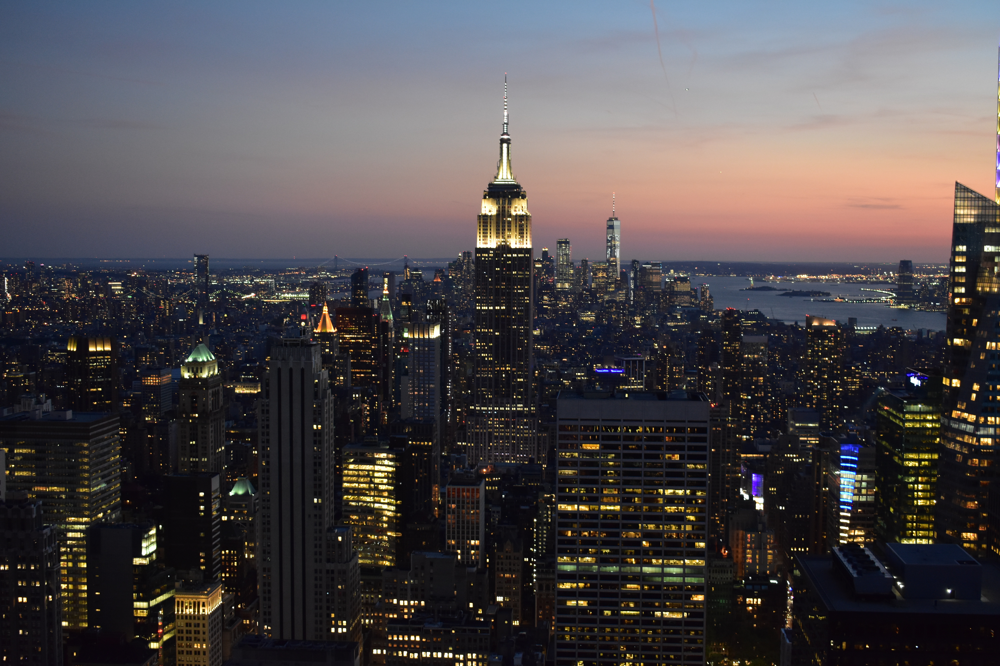

greedy_search: man is standing on the edge of the edge of the ocean

Beam search: man and woman sit on the beach

	Beam width: 5


In [38]:
img_file = "/Users/zhidongzhang/Pictures/Photos Library.photoslibrary/originals/0/03D1D7C2-8BA6-4636-AED6-3C321FD07638.jpeg"

inference(img_file)

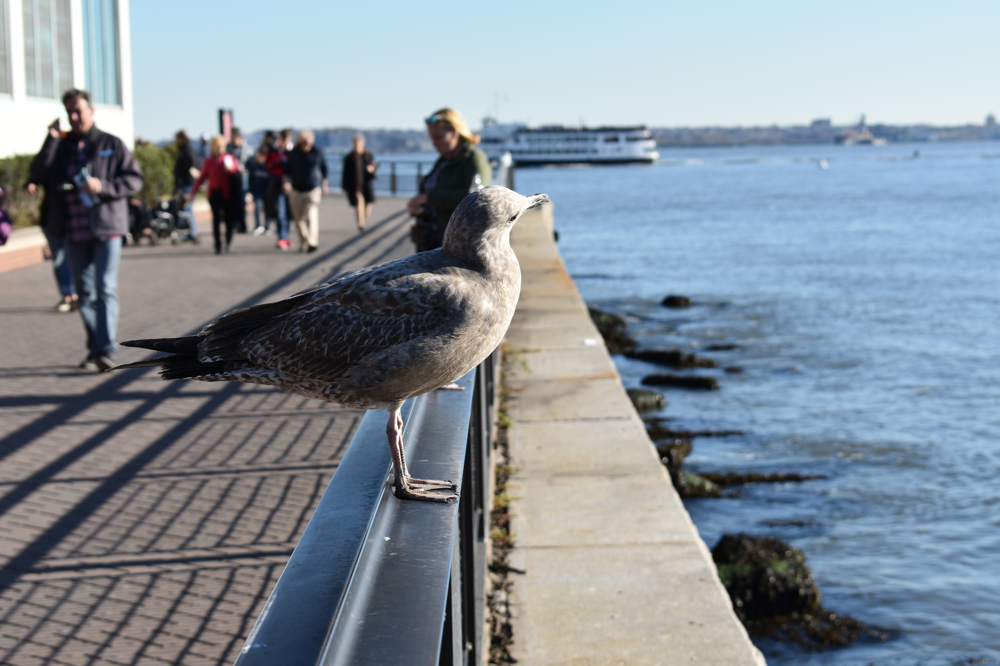

greedy_search: two people sit on dock near the water

Beam search: two people sit on dock

	Beam width: 10


In [39]:
img_file = "/Users/zhidongzhang/Pictures/Photos Library.photoslibrary/originals/0/0AFE403A-7EE3-4BEF-B85B-0B3B79426707.jpeg"

inference(img_file)

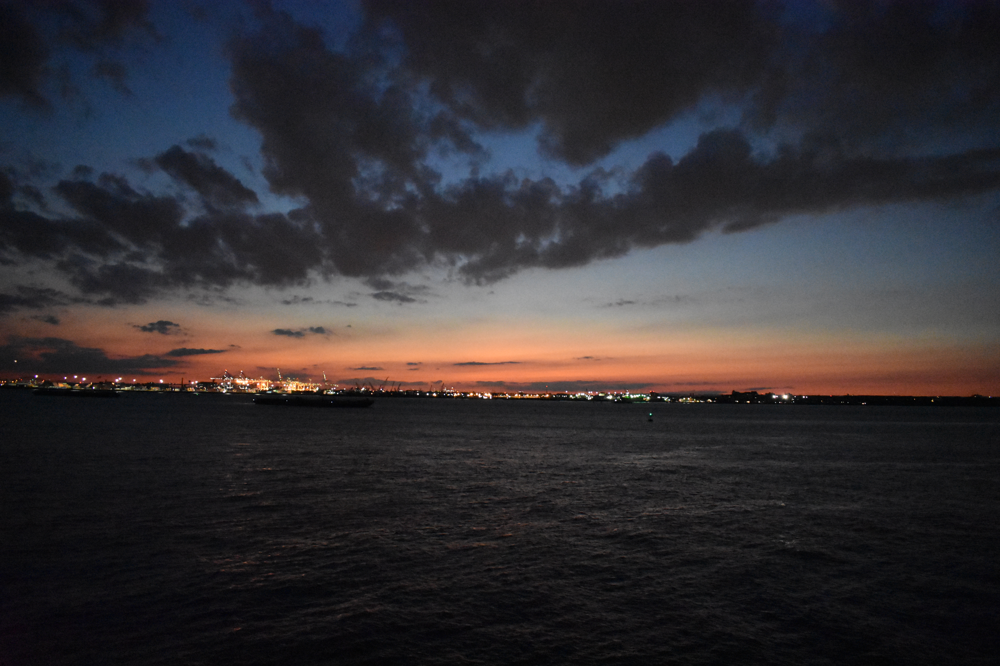

greedy_search: man is standing on the beach near the ocean

Beam search: two people are sitting on the beach

	Beam width: 5


In [40]:
img_file = "/Users/zhidongzhang/Pictures/Photos Library.photoslibrary/originals/0/0F3394A2-5482-4E0A-8A4E-8E56E7031F25.jpeg"

inference(img_file)

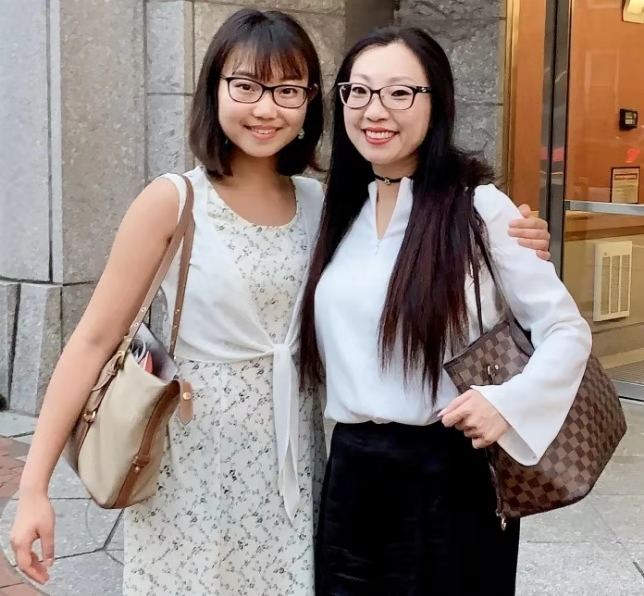

greedy_search: two girls in formal clothes are standing in front of the street

Beam search: two young girls stand on the street

	Beam width: 5


In [41]:
img_file = "personal_test_image/12711573668962_.pic.jpg"

inference(img_file)

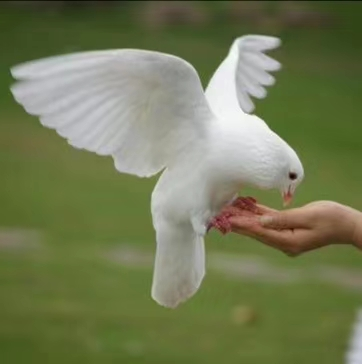

greedy_search: bird is running through the air

Beam search: white bird is running through the water

	Beam width: 3


In [42]:
img_file = "personal_test_image/12721573669049_.pic.jpg"

inference(img_file)

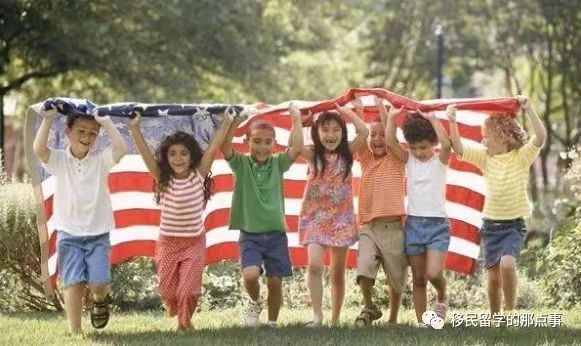

greedy_search: two children are playing with colorful swords

Beam search: two children are playing on the grass

	Beam width: 3


In [43]:
img_file = "personal_test_image/12731573669179_.pic.jpg"

inference(img_file)

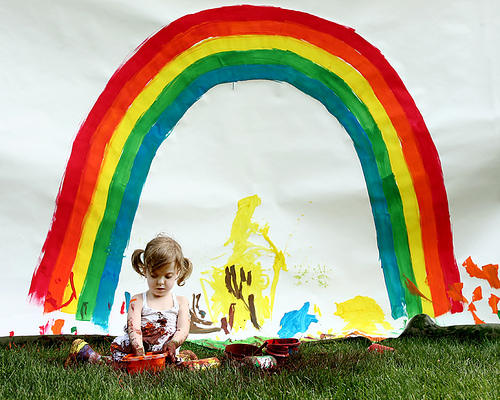

greedy_search: girl in pink dress is jumping on the grass

Beam search: two children playing in the grass

	Beam width: 10


In [44]:
img_file = img_dir + "1002674143_1b742ab4b8.jpg"

inference(img_file)

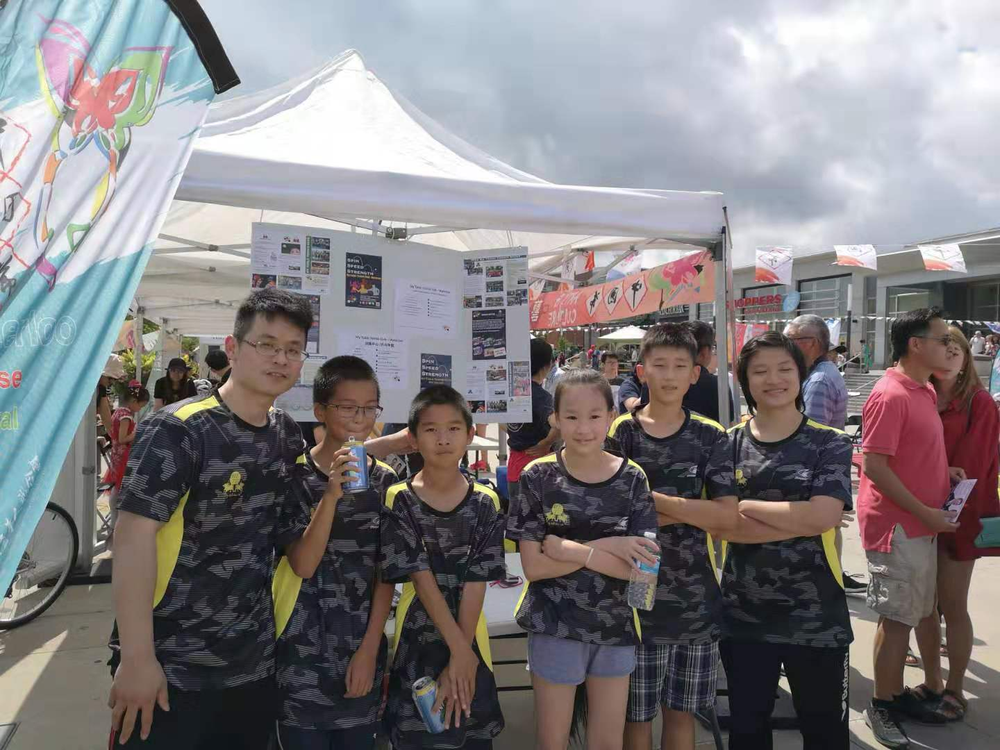

greedy_search: group of people are gathered in front of an amusement street

Beam search: group of people stand on the street

	Beam width: 10


In [45]:
img_file =  "personal_test_image/WechatIMG35.jpeg"

inference(img_file)

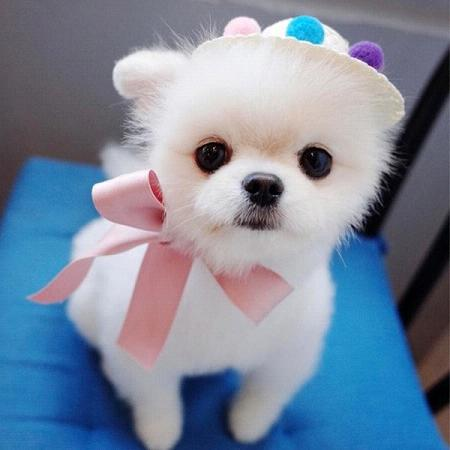

greedy_search: two dogs are running through the grass

Beam search: black and white dog is running through the snow

	Beam width: 7


In [333]:
img_file =  "personal_test_image/1554274317-gWjtOnLlzq.jpg"

inference(img_file)